In [1]:
import pandas as pd
import numpy as np
pd.set_option('display.max_columns', 30)

import seaborn as sns
sns.set(style="ticks", color_codes=True)
import matplotlib.pyplot as plt

In [2]:
df1 = pd.read_csv('../Datasets/Autism-Adult-Data.csv')
df2 = pd.read_csv('../Datasets/Autism-Child-Data.csv')
df3 = pd.read_csv('../Datasets/Autism-Adolescent-Data.csv')

In [3]:
df = pd.concat([df1, df2, df3])

In [4]:
df.head()

,A1_Score,A2_Score,A3_Score,A4_Score,A5_Score,A6_Score,A7_Score,A8_Score,A9_Score,A10_Score,age,gender,ethnicity,jundice,austim,contry_of_res,used_app_before,result,age_desc,relation,Class/ASD
0,1,1,1,1,0,0,1,1,0,0,26,f,White-European,no,no,'United States',no,6,'18 and more',Self,NO
1,1,1,0,1,0,0,0,1,0,1,24,m,Latino,no,yes,Brazil,no,5,'18 and more',Self,NO
2,1,1,0,1,1,0,1,1,1,1,27,m,Latino,yes,yes,Spain,no,8,'18 and more',Parent,YES
3,1,1,0,1,0,0,1,1,0,1,35,f,White-European,no,yes,'United States',no,6,'18 and more',Self,NO
4,1,0,0,0,0,0,0,1,0,0,40,f,?,no,no,Egypt,no,2,'18 and more',?,NO


In [5]:
df.isnull().values.any()

False

In [6]:
df.replace('?', np.NaN, inplace=True)

In [7]:
sum(df.isna().values)

array([  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   6,   0, 144,
         0,   0,   0,   0,   0,   0, 144,   0])

In [8]:
# df.drop(['relation', 'ethnicity','age'], axis=1, inplace=True)
df.drop(['age'], axis=1, inplace=True)

In [9]:
df.head()

,A1_Score,A2_Score,A3_Score,A4_Score,A5_Score,A6_Score,A7_Score,A8_Score,A9_Score,A10_Score,gender,ethnicity,jundice,austim,contry_of_res,used_app_before,result,age_desc,relation,Class/ASD
0,1,1,1,1,0,0,1,1,0,0,f,White-European,no,no,'United States',no,6,'18 and more',Self,NO
1,1,1,0,1,0,0,0,1,0,1,m,Latino,no,yes,Brazil,no,5,'18 and more',Self,NO
2,1,1,0,1,1,0,1,1,1,1,m,Latino,yes,yes,Spain,no,8,'18 and more',Parent,YES
3,1,1,0,1,0,0,1,1,0,1,f,White-European,no,yes,'United States',no,6,'18 and more',Self,NO
4,1,0,0,0,0,0,0,1,0,0,f,NaN,no,no,Egypt,no,2,'18 and more',NaN,NO


In [10]:
df.replace('f', 0, inplace=True)
df.replace('m', 1, inplace=True)

In [11]:
df.isna().any()

A1_Score           False
A2_Score           False
A3_Score           False
A4_Score           False
A5_Score           False
A6_Score           False
A7_Score           False
A8_Score           False
A9_Score           False
A10_Score          False
gender             False
ethnicity           True
jundice            False
austim             False
contry_of_res      False
used_app_before    False
result             False
age_desc           False
relation            True
Class/ASD          False
dtype: bool

In [12]:
df.drop(['ethnicity'], axis=1, inplace=True)

In [13]:
df.rename(columns={"jundice": "jaundice"}, inplace=True)
df.replace('no', 0, inplace=True)
df.replace('yes', 1, inplace=True)

In [14]:
df.drop(['contry_of_res'], axis=1, inplace=True)

In [15]:
print(sum(df['used_app_before'] == 0))
print(sum(df['used_app_before'] == 1))

1073
27


In [16]:
df.drop(['used_app_before', 'result', 'relation'], axis=1, inplace=True)

In [17]:
df.rename(columns={"austim": "PDD"}, inplace=True)

In [18]:
df['age_desc'].replace("'12-15 years'", "'12-16 years'", inplace=True)

In [19]:
df = pd.concat([df,pd.get_dummies(df['age_desc'], prefix='age_range')], axis=1)
df.drop(['age_desc'],axis=1, inplace=True)

In [20]:
df.replace('NO', 0, inplace=True)
df.replace('YES', 1, inplace=True)

In [21]:
df.head()

,A1_Score,A2_Score,A3_Score,A4_Score,A5_Score,A6_Score,A7_Score,A8_Score,A9_Score,A10_Score,gender,jaundice,PDD,Class/ASD,age_range_'12-16 years',age_range_'18 and more',age_range_'4-11 years'
0,1,1,1,1,0,0,1,1,0,0,0,0,0,0,0,1,0
1,1,1,0,1,0,0,0,1,0,1,1,0,1,0,0,1,0
2,1,1,0,1,1,0,1,1,1,1,1,1,1,1,0,1,0
3,1,1,0,1,0,0,1,1,0,1,0,0,1,0,0,1,0
4,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0


In [22]:
df.shape

(1100, 17)

#### Checking if there are any null values in the data frame

In [23]:
df.isnull().values.any()

False

In [24]:
df.to_csv('../Datasets/Final_Dataset.csv')

In [25]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
A1_Score,1100.0,0.699091,0.458862,0.0,0.0,1.0,1.0,1.0
A2_Score,1100.0,0.482727,0.499929,0.0,0.0,0.0,1.0,1.0
A3_Score,1100.0,0.551818,0.497534,0.0,0.0,1.0,1.0,1.0
A4_Score,1100.0,0.530000,0.499326,0.0,0.0,1.0,1.0,1.0
A5_Score,1100.0,0.587273,0.492548,0.0,0.0,1.0,1.0,1.0
A6_Score,1100.0,0.443636,0.497039,0.0,0.0,0.0,1.0,1.0
A7_Score,1100.0,0.477273,0.499710,0.0,0.0,0.0,1.0,1.0
A8_Score,1100.0,0.605455,0.488975,0.0,0.0,1.0,1.0,1.0
A9_Score,1100.0,0.412727,0.492548,0.0,0.0,0.0,1.0,1.0
A10_Score,1100.0,0.621818,0.485154,0.0,0.0,1.0,1.0,1.0


#### Displaying data types for each column in data frame

In [26]:
dfDataType = df.dtypes
dfDataType

A1_Score                   int64
A2_Score                   int64
A3_Score                   int64
A4_Score                   int64
A5_Score                   int64
A6_Score                   int64
A7_Score                   int64
A8_Score                   int64
A9_Score                   int64
A10_Score                  int64
gender                     int64
jaundice                   int64
PDD                        int64
Class/ASD                  int64
age_range_'12-16 years'    uint8
age_range_'18 and more'    uint8
age_range_'4-11 years'     uint8
dtype: object

#### Displaying correlation between values of features and "Class/ASD"

In [27]:
df.corr()["Class/ASD"].sort_values()

age_range_'18 and more'   -0.247099
gender                    -0.027942
jaundice                   0.079960
PDD                        0.092836
age_range_'4-11 years'     0.157571
age_range_'12-16 years'    0.167569
A8_Score                   0.275809
A2_Score                   0.285832
A1_Score                   0.290603
A7_Score                   0.347273
A10_Score                  0.421044
A3_Score                   0.462104
A4_Score                   0.508243
A5_Score                   0.520985
A6_Score                   0.567634
A9_Score                   0.596497
Class/ASD                  1.000000
Name: Class/ASD, dtype: float64

#### Plotting graphs to show feature relationship with "Class/ASD" feature

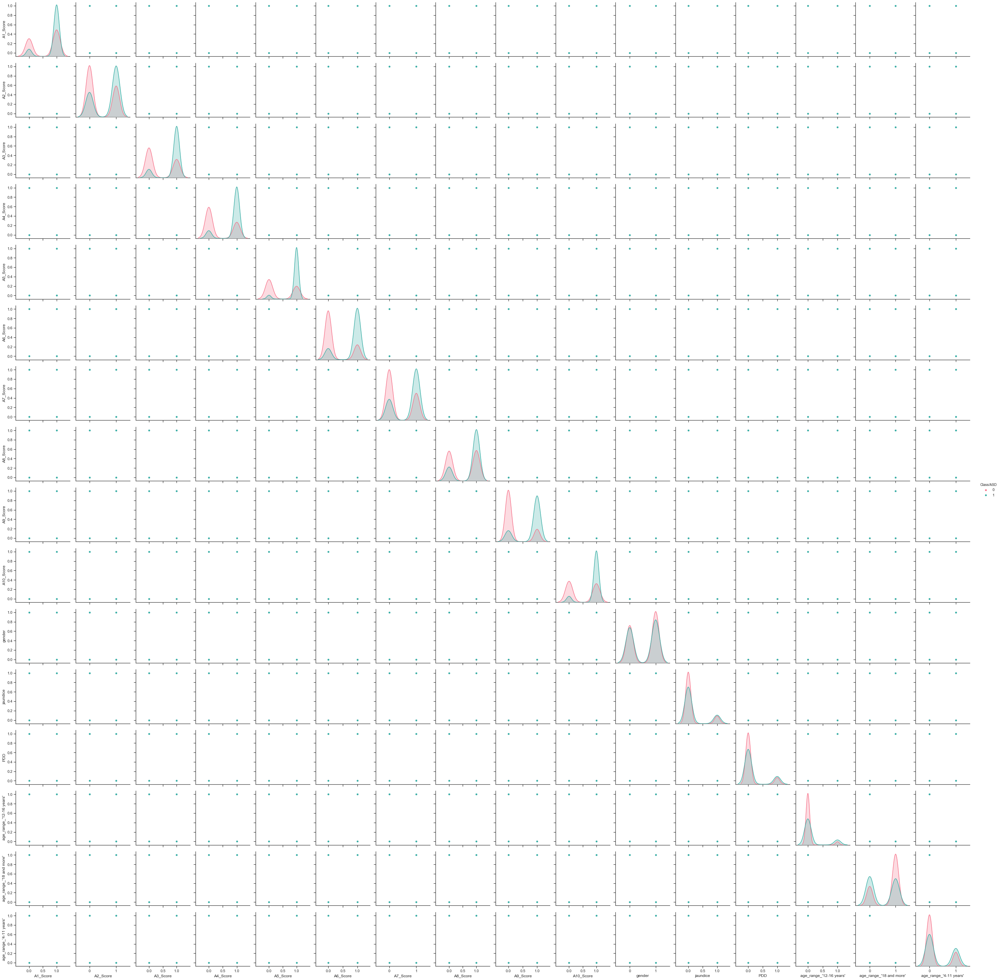

In [28]:
sns_pair_plot = sns.pairplot(df, hue = "Class/ASD", palette = "husl", size = 2.5)
sns_pair_plot.savefig("../Outputs/pair_plot.png")

#### Plotting distribution of values in feature "A1_Score"

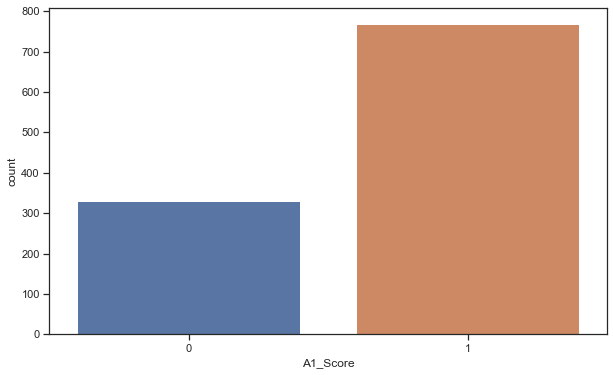

In [29]:
plt.figure(figsize = (10,6))
A1Score_countplot = sns.countplot(df["A1_Score"])
fig_a1_score = A1Score_countplot.get_figure()
fig_a1_score.savefig("../Outputs/A1Score_countplot.png")

#### Plotting distribution of values in feature "A2_Score"

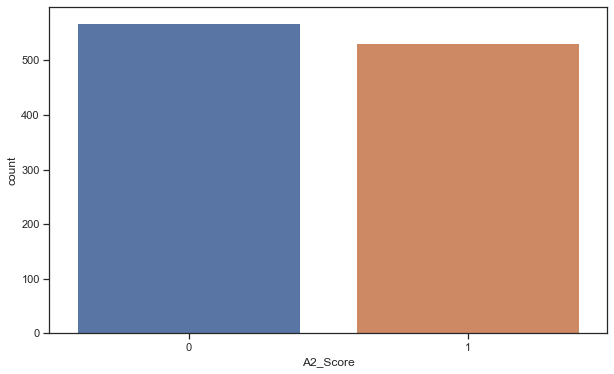

In [30]:
plt.figure(figsize = (10,6))
A2Score_countplot = sns.countplot(df["A2_Score"])
fig_a2_score = A2Score_countplot.get_figure()
fig_a2_score.savefig("../Outputs/A2Score_countplot.png")

#### Plotting distribution of values in feature "A3_Score"

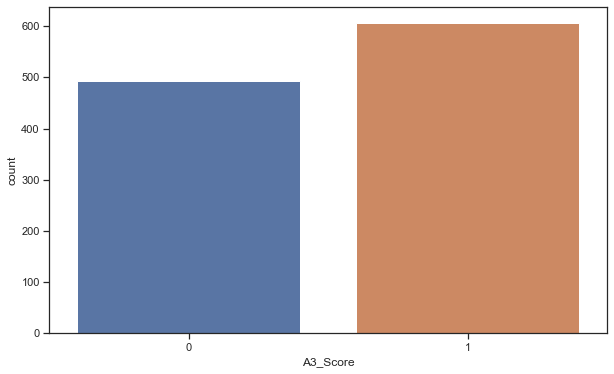

In [31]:
plt.figure(figsize = (10,6))
A3Score_countplot = sns.countplot(df["A3_Score"])
fig_a3_score = A3Score_countplot.get_figure()
fig_a3_score.savefig("../Outputs/A3Score_countplot.png")

#### Plotting distribution of values in feature "A4_Score"

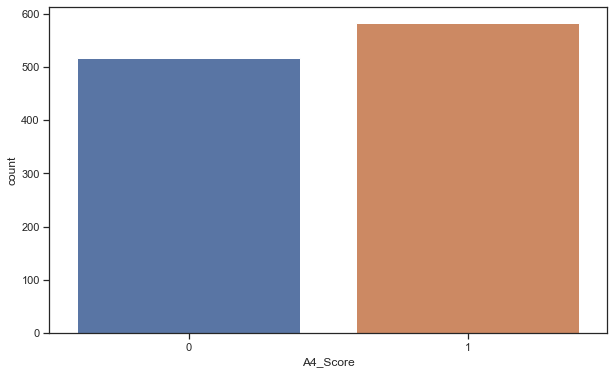

In [32]:
plt.figure(figsize = (10,6))
A4Score_countplot = sns.countplot(df["A4_Score"])
fig_a4_score = A4Score_countplot.get_figure()
fig_a4_score.savefig("../Outputs/A4Score_countplot.png")

#### Plotting distribution of values in feature "A5_Score"

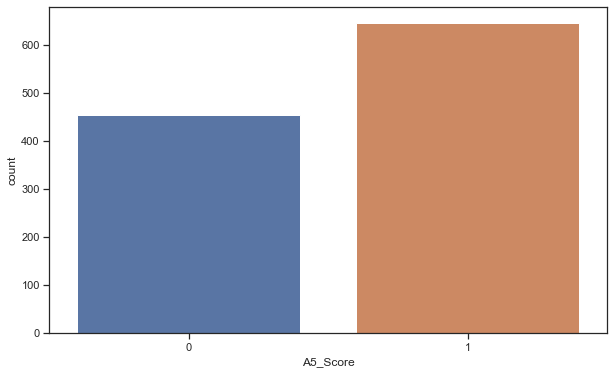

In [33]:
plt.figure(figsize = (10,6))
A5Score_countplot = sns.countplot(df["A5_Score"])
fig_a5_score = A5Score_countplot.get_figure()
fig_a5_score.savefig("../Outputs/A5Score_countplot.png")

#### Plotting distribution of values in feature "A6_Score"

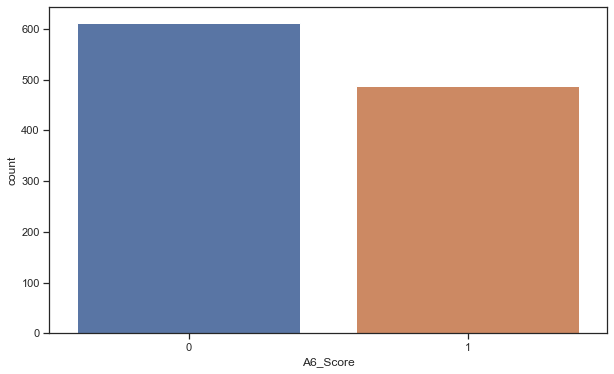

In [34]:
plt.figure(figsize = (10,6))
A6Score_countplot = sns.countplot(df["A6_Score"])
fig_a6_score = A6Score_countplot.get_figure()
fig_a6_score.savefig("../Outputs/A6Score_countplot.png")

#### Plotting distribution of values in feature "A7_Score"

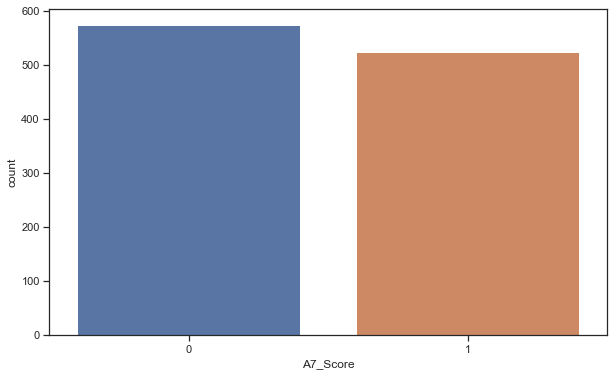

In [35]:
plt.figure(figsize = (10,6))
A7Score_countplot = sns.countplot(df["A7_Score"])
fig_a7_score = A7Score_countplot.get_figure()
fig_a7_score.savefig("../Outputs/A7Score_countplot.png")

#### Plotting distribution of values in feature "A8_Score"

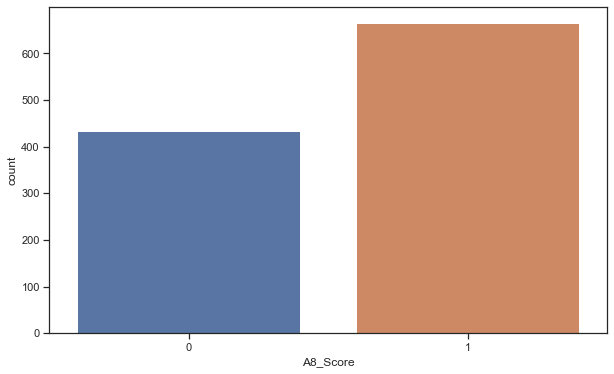

In [36]:
plt.figure(figsize = (10,6))
A8Score_countplot = sns.countplot(df["A8_Score"])
fig_a8_score = A8Score_countplot.get_figure()
fig_a8_score.savefig("../Outputs/A8Score_countplot.png")

#### Plotting distribution of values in feature "A9_Score"

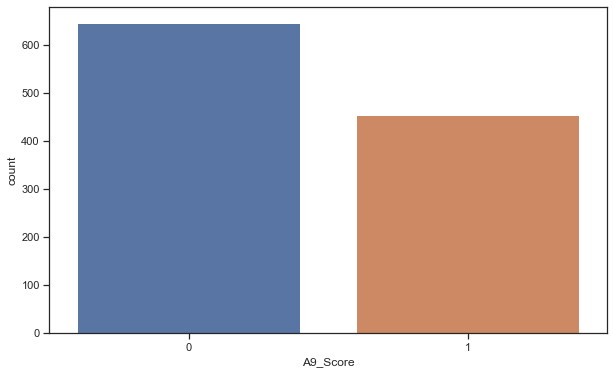

In [37]:
plt.figure(figsize = (10,6))
A9Score_countplot = sns.countplot(df["A9_Score"])
fig_a9_score = A9Score_countplot.get_figure()
fig_a9_score.savefig("../Outputs/A9Score_countplot.png")

#### Plotting distribution of values in feature "A10_Score"

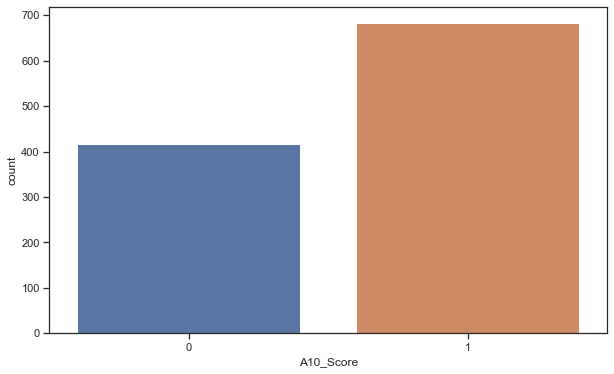

In [38]:
plt.figure(figsize = (10,6))
A10Score_countplot = sns.countplot(df["A10_Score"])
fig_a10_score = A10Score_countplot.get_figure()
fig_a10_score.savefig("../Outputs/A10Score_countplot.png")

#### Plotting distribution of values in feature "gender"

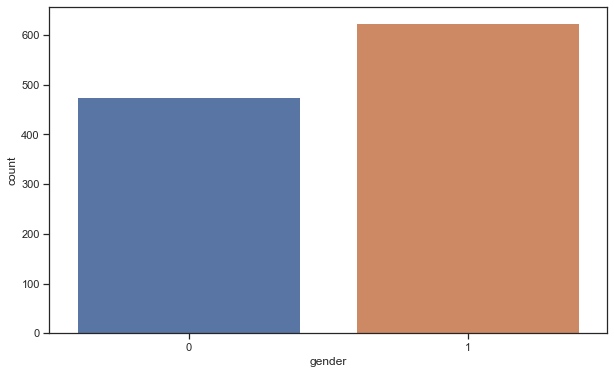

In [39]:
plt.figure(figsize = (10,6))
gender_countplot = sns.countplot(df["gender"])
fig_gender = gender_countplot.get_figure()
fig_gender.savefig("../Outputs/gender_countplot.png")

#### Plotting distribution of values in feature "jaundice"

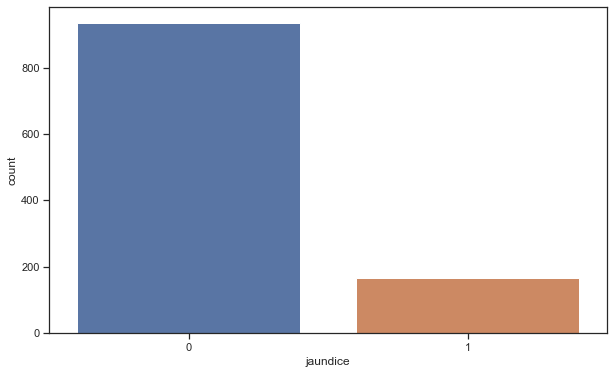

In [40]:
plt.figure(figsize = (10,6))
jaundice_countplot = sns.countplot(df["jaundice"])
fig_jaundice = jaundice_countplot.get_figure()
fig_jaundice.savefig("../Outputs/jaundice_countplot.png")

#### Plotting distribution of values in feature "PDD"

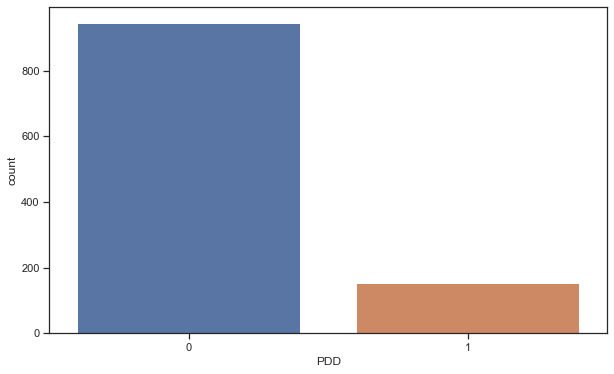

In [41]:
plt.figure(figsize = (10,6))
pdd_countplot = sns.countplot(df["PDD"])
fig_pdd = pdd_countplot.get_figure()
fig_pdd.savefig("../Outputs/pdd_countplot.png")

#### Plotting distribution of values in feature "Class/ASD"

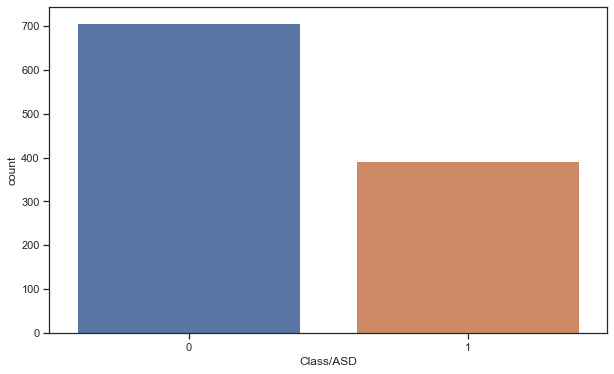

In [42]:
plt.figure(figsize = (10,6))
class_asd_countplot = sns.countplot(df["Class/ASD"])
fig_class_asd = class_asd_countplot.get_figure()
fig_class_asd.savefig("../Outputs/class_asd_countplot.png")

#### Plotting distribution of values in feature "age\_range\_'12-16 years'"

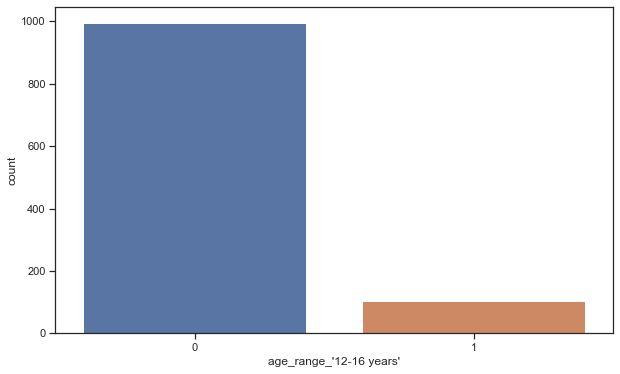

In [43]:
plt.figure(figsize = (10,6))
age_12_16_countplot = sns.countplot(df["age_range_'12-16 years'"])
fig_age_12_16 = age_12_16_countplot.get_figure()
fig_age_12_16.savefig("../Outputs/age_12_16_countplot.png")

#### Plotting distribution of values in feature "age\_range\_'18 and more'"

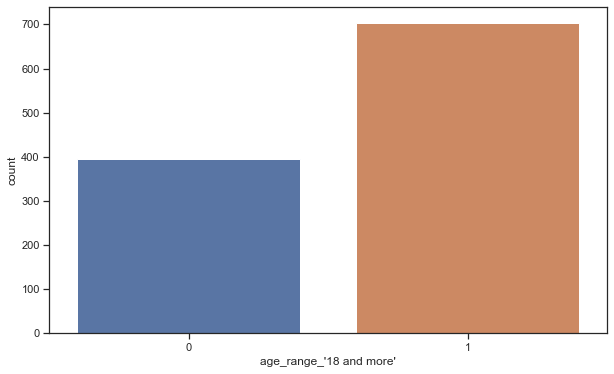

In [44]:
plt.figure(figsize = (10,6))
age_18_more_countplot = sns.countplot(df["age_range_'18 and more'"])
fig_age_18_more = age_18_more_countplot.get_figure()
fig_age_18_more.savefig("../Outputs/age_18_more_countplot.png")

#### Plotting distribution of values in feature "age\_range\_'4-11 years'"

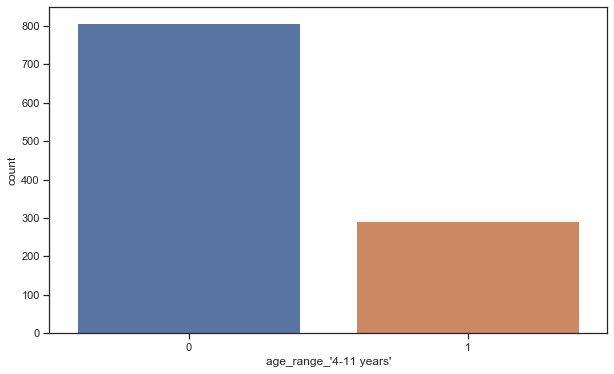

In [45]:
plt.figure(figsize = (10,6))
age_4_11_countplot = sns.countplot(df["age_range_'4-11 years'"])
fig_age_4_11 = age_4_11_countplot.get_figure()
fig_age_4_11.savefig("../Outputs/age_4_11_countplot.png")